In [ ]:
'''

Assignment 1: Breast Cancer Classification
Dataset: Breast Cancer Wisconsin
Link: https://raw.githubusercontent.com/plotly/datasets/master/data.csv
Task:
 Classify benign/malignant tumors.
 Handle missing values in BareNuclei.
 Encode diagnostic labels.
 Use StandardScaler before KNN (important).
 Tune K = 3,5,7 and compare results.
'''

In [3]:
import pandas as pd


C:\Users\Saikat Maiti\Downloads\Anaconda\Lib\site-packages\pandas\core\arrays\masked.py:61: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


In [4]:
df = pd.read_csv('Breast Cancer Wisconsin (Diagnostic) Data Set.csv')   ## upload the dataset

In [5]:
df ## print the dataset

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,...,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,...,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,...,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,...,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,...,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,926424,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,...,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115,NaN
565,926682,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,...,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637,NaN
566,926954,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,...,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820,NaN
567,927241,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,...,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400,NaN


In [6]:
df1= df.drop(['Unnamed: 32','id'],axis=1) ## delete this two colum from the dataset

In [7]:
df1  ## print new dataset

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,...,25.380,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890
1,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,...,24.990,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902
2,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,...,23.570,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758
3,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,...,14.910,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300
4,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,...,22.540,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,...,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
565,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,...,23.690,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
566,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,...,18.980,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
567,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,...,25.740,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400


In [8]:
df1.isnull().sum()   ## check null value present or not

diagnosis                  0
radius_mean                0
texture_mean               0
perimeter_mean             0
area_mean                  0
smoothness_mean            0
compactness_mean           0
concavity_mean             0
concave points_mean        0
symmetry_mean              0
fractal_dimension_mean     0
radius_se                  0
texture_se                 0
perimeter_se               0
area_se                    0
smoothness_se              0
compactness_se             0
concavity_se               0
concave points_se          0
symmetry_se                0
fractal_dimension_se       0
radius_worst               0
texture_worst              0
perimeter_worst            0
area_worst                 0
smoothness_worst           0
compactness_worst          0
concavity_worst            0
concave points_worst       0
symmetry_worst             0
fractal_dimension_worst    0
dtype: int64

In [9]:
from sklearn.preprocessing import LabelEncoder  

In [10]:
le = LabelEncoder()  ## create object of labelencoder

In [11]:
le.fit(df1['diagnosis'])  ## fit the diagnosis column into labelencoder

LabelEncoder()

In [12]:
df1['diagnosis'] = le.transform(df1['diagnosis'])  ## transform from categorical to labelling 

In [13]:
le.classes_

array(['B', 'M'], dtype=object)

In [14]:
df1  ## after labelling the diagnosis column print the data set

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,1,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,...,25.380,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890
1,1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,...,24.990,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902
2,1,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,...,23.570,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758
3,1,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,...,14.910,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300
4,1,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,...,22.540,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,1,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,...,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
565,1,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,...,23.690,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
566,1,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,...,18.980,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
567,1,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,...,25.740,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400


In [15]:
df1.iloc[:,1:31].corr()  ## check correlation in dataset

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
radius_mean,1.000000,0.323782,0.997855,0.987357,0.170581,0.506124,0.676764,0.822529,0.147741,-0.311631,...,0.969539,0.297008,0.965137,0.941082,0.119616,0.413463,0.526911,0.744214,0.163953,0.007066
texture_mean,0.323782,1.000000,0.329533,0.321086,-0.023389,0.236702,0.302418,0.293464,0.071401,-0.076437,...,0.352573,0.912045,0.358040,0.343546,0.077503,0.277830,0.301025,0.295316,0.105008,0.119205
perimeter_mean,0.997855,0.329533,1.000000,0.986507,0.207278,0.556936,0.716136,0.850977,0.183027,-0.261477,...,0.969476,0.303038,0.970387,0.941550,0.150549,0.455774,0.563879,0.771241,0.189115,0.051019
area_mean,0.987357,0.321086,0.986507,1.000000,0.177028,0.498502,0.685983,0.823269,0.151293,-0.283110,...,0.962746,0.287489,0.959120,0.959213,0.123523,0.390410,0.512606,0.722017,0.143570,0.003738
smoothness_mean,0.170581,-0.023389,0.207278,0.177028,1.000000,0.659123,0.521984,0.553695,0.557775,0.584792,...,0.213120,0.036072,0.238853,0.206718,0.805324,0.472468,0.434926,0.503053,0.394309,0.499316
compactness_mean,0.506124,0.236702,0.556936,0.498502,0.659123,1.000000,0.883121,0.831135,0.602641,0.565369,...,0.535315,0.248133,0.590210,0.509604,0.565541,0.865809,0.816275,0.815573,0.510223,0.687382
concavity_mean,0.676764,0.302418,0.716136,0.685983,0.521984,0.883121,1.000000,0.921391,0.500667,0.336783,...,0.688236,0.299879,0.729565,0.675987,0.448822,0.754968,0.884103,0.861323,0.409464,0.514930
concave points_mean,0.822529,0.293464,0.850977,0.823269,0.553695,0.831135,0.921391,1.000000,0.462497,0.166917,...,0.830318,0.292752,0.855923,0.809630,0.452753,0.667454,0.752399,0.910155,0.375744,0.368661
symmetry_mean,0.147741,0.071401,0.183027,0.151293,0.557775,0.602641,0.500667,0.462497,1.000000,0.479921,...,0.185728,0.090651,0.219169,0.177193,0.426675,0.473200,0.433721,0.430297,0.699826,0.438413
fractal_dimension_mean,-0.311631,-0.076437,-0.261477,-0.283110,0.584792,0.565369,0.336783,0.166917,0.479921,1.000000,...,-0.253691,-0.051269,-0.205151,-0.231854,0.504942,0.458798,0.346234,0.175325,0.334019,0.767297


In [16]:
## print which correlation is greater than 98 
x = df1.iloc[:,1:31].corr() > abs(0.98)
for i in range(0,30):
    for j in range(0,30):
        if x.iloc[i,j] == True:
            print(x.columns[i],x.columns[j])
       

radius_mean radius_mean
radius_mean perimeter_mean
radius_mean area_mean
texture_mean texture_mean
perimeter_mean radius_mean
perimeter_mean perimeter_mean
perimeter_mean area_mean
area_mean radius_mean
area_mean perimeter_mean
area_mean area_mean
smoothness_mean smoothness_mean
compactness_mean compactness_mean
concavity_mean concavity_mean
concave points_mean concave points_mean
symmetry_mean symmetry_mean
fractal_dimension_mean fractal_dimension_mean
radius_se radius_se
texture_se texture_se
perimeter_se perimeter_se
area_se area_se
smoothness_se smoothness_se
compactness_se compactness_se
concavity_se concavity_se
concave points_se concave points_se
symmetry_se symmetry_se
fractal_dimension_se fractal_dimension_se
radius_worst radius_worst
radius_worst perimeter_worst
radius_worst area_worst
texture_worst texture_worst
perimeter_worst radius_worst
perimeter_worst perimeter_worst
area_worst radius_worst
area_worst area_worst
smoothness_worst smoothness_worst
compactness_worst compac

In [17]:
import seaborn as sns
import matplotlib.pyplot as plt

In [18]:
sns.pairplot(df1.iloc[:,1:31])

C:\Users\Saikat Maiti\Downloads\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Saikat Maiti\Downloads\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Saikat Maiti\Downloads\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Saikat Maiti\Downloads\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed

In [19]:
 ##  delete this column for Distance becomes biased (perimeter mean , area_mean , perimeter worst , area worst)

In [20]:
df2 = df1.drop(['area_mean','area_worst','perimeter_mean','perimeter_worst'],axis=1) ## drop this column

In [21]:
df2  ## print new dataset

,diagnosis,radius_mean,texture_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,...,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,1,17.99,10.38,0.11840,0.27760,0.30010,0.14710,0.2419,0.07871,1.0950,...,0.03003,0.006193,25.380,17.33,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890
1,1,20.57,17.77,0.08474,0.07864,0.08690,0.07017,0.1812,0.05667,0.5435,...,0.01389,0.003532,24.990,23.41,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902
2,1,19.69,21.25,0.10960,0.15990,0.19740,0.12790,0.2069,0.05999,0.7456,...,0.02250,0.004571,23.570,25.53,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758
3,1,11.42,20.38,0.14250,0.28390,0.24140,0.10520,0.2597,0.09744,0.4956,...,0.05963,0.009208,14.910,26.50,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300
4,1,20.29,14.34,0.10030,0.13280,0.19800,0.10430,0.1809,0.05883,0.7572,...,0.01756,0.005115,22.540,16.67,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,1,21.56,22.39,0.11100,0.11590,0.24390,0.13890,0.1726,0.05623,1.1760,...,0.01114,0.004239,25.450,26.40,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
565,1,20.13,28.25,0.09780,0.10340,0.14400,0.09791,0.1752,0.05533,0.7655,...,0.01898,0.002498,23.690,38.25,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
566,1,16.60,28.08,0.08455,0.10230,0.09251,0.05302,0.1590,0.05648,0.4564,...,0.01318,0.003892,18.980,34.12,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
567,1,20.60,29.33,0.11780,0.27700,0.35140,0.15200,0.2397,0.07016,0.7260,...,0.02324,0.006185,25.740,39.42,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400


In [22]:
df2.iloc[:,1:27].corr()  ## check correlation insteadof diagnosis columnn

,radius_mean,texture_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,...,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
radius_mean,1.000000,0.323782,0.170581,0.506124,0.676764,0.822529,0.147741,-0.311631,0.679090,-0.097317,...,-0.104321,-0.042641,0.969539,0.297008,0.119616,0.413463,0.526911,0.744214,0.163953,0.007066
texture_mean,0.323782,1.000000,-0.023389,0.236702,0.302418,0.293464,0.071401,-0.076437,0.275869,0.386358,...,0.009127,0.054458,0.352573,0.912045,0.077503,0.277830,0.301025,0.295316,0.105008,0.119205
smoothness_mean,0.170581,-0.023389,1.000000,0.659123,0.521984,0.553695,0.557775,0.584792,0.301467,0.068406,...,0.200774,0.283607,0.213120,0.036072,0.805324,0.472468,0.434926,0.503053,0.394309,0.499316
compactness_mean,0.506124,0.236702,0.659123,1.000000,0.883121,0.831135,0.602641,0.565369,0.497473,0.046205,...,0.229977,0.507318,0.535315,0.248133,0.565541,0.865809,0.816275,0.815573,0.510223,0.687382
concavity_mean,0.676764,0.302418,0.521984,0.883121,1.000000,0.921391,0.500667,0.336783,0.631925,0.076218,...,0.178009,0.449301,0.688236,0.299879,0.448822,0.754968,0.884103,0.861323,0.409464,0.514930
concave points_mean,0.822529,0.293464,0.553695,0.831135,0.921391,1.000000,0.462497,0.166917,0.698050,0.021480,...,0.095351,0.257584,0.830318,0.292752,0.452753,0.667454,0.752399,0.910155,0.375744,0.368661
symmetry_mean,0.147741,0.071401,0.557775,0.602641,0.500667,0.462497,1.000000,0.479921,0.303379,0.128053,...,0.449137,0.331786,0.185728,0.090651,0.426675,0.473200,0.433721,0.430297,0.699826,0.438413
fractal_dimension_mean,-0.311631,-0.076437,0.584792,0.565369,0.336783,0.166917,0.479921,1.000000,0.000111,0.164174,...,0.345007,0.688132,-0.253691,-0.051269,0.504942,0.458798,0.346234,0.175325,0.334019,0.767297
radius_se,0.679090,0.275869,0.301467,0.497473,0.631925,0.698050,0.303379,0.000111,1.000000,0.213247,...,0.240567,0.227754,0.715065,0.194799,0.141919,0.287103,0.380585,0.531062,0.094543,0.049559
texture_se,-0.097317,0.386358,0.068406,0.046205,0.076218,0.021480,0.128053,0.164174,0.213247,1.000000,...,0.411621,0.279723,-0.111690,0.409003,-0.073658,-0.092439,-0.068956,-0.119638,-0.128215,-0.045655


C:\Users\Saikat Maiti\Downloads\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Saikat Maiti\Downloads\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Saikat Maiti\Downloads\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Saikat Maiti\Downloads\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed

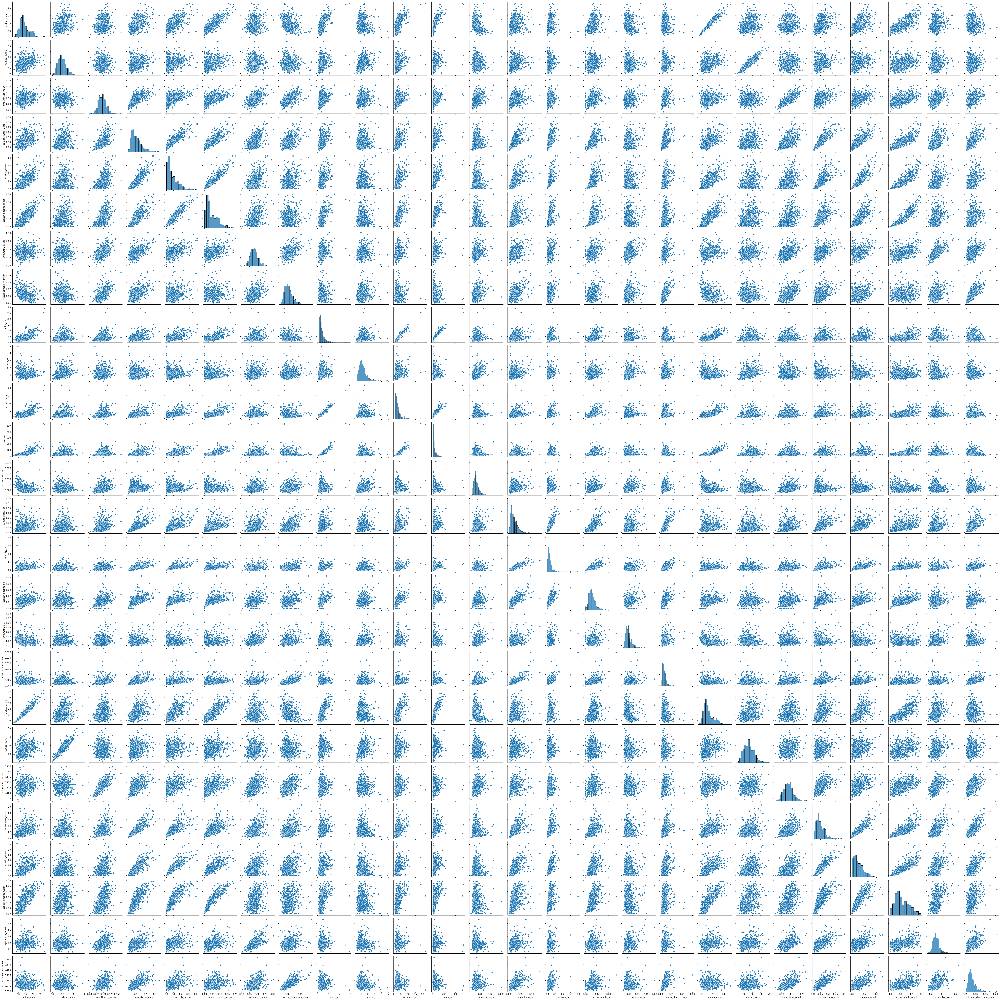

In [23]:
sns.pairplot(df2.iloc[:,1:27])

In [24]:
x = df2.iloc[:,1:27]

In [25]:
y = df2['diagnosis']

In [26]:
from sklearn.model_selection import train_test_split

In [27]:
x_train , x_test , y_train , y_test = train_test_split(x,y,test_size=0.2)

In [28]:
from sklearn.preprocessing import StandardScaler

In [29]:
scaler = StandardScaler()  ## create object of standard scaler

In [50]:
## unique value of x_train

for i in range(x_train.shape[1]):
    print(f'Unique value of {x_train.columns[i]} is : ',x_train[x_train.columns[i]].unique(),'\n\n')

Unique value of radius_mean is :  [10.97  19.17  13.21  10.26  13.74  13.68   9.847 15.27  11.26  19.73
 12.25  16.03  17.99  16.46  11.67  11.71  11.64   8.95  18.08  20.58
 17.75  11.84  13.15  19.59  11.22  12.36  14.45  13.27  10.48  17.29
 16.14  16.13  11.33  10.57  14.05  10.16  15.75  11.99  17.2   21.1
 19.55   7.691 12.21  12.89  12.4   14.11  13.47  20.18  17.46  12.87
 11.2   20.64  10.66  11.69  12.18  13.61  14.06  15.3   10.29  12.88
  8.671 18.81   9.042 11.6   16.69  14.6   13.05  14.22  18.45  16.78
 17.3   14.54  11.3   15.5   11.81  14.95  13.43  13.    14.81  12.03
 12.76  12.62  20.34  10.03   9.904 12.86  16.74  13.46  11.54  19.79
 13.75   9.606 19.53  11.06  11.13  25.73  10.05  13.3    8.219 12.95
 19.07  18.46  14.4   17.14  13.64  13.45  11.94  10.8   18.49  20.51
 17.27  12.39  12.9   11.89   9.    17.57   9.295  9.676 12.27  14.2
 11.93  15.46  20.48  19.18  14.69  15.04  19.19  11.45  17.93  10.49
 14.5   12.46  14.58  21.75  18.61  14.87  13.56  10.91  1

In [ ]:
## scaling --> radius_mean , texture_mean , texture_se , perimeter_se , area_se , radius_worst ,texture_worst 

In [51]:
col5 = ['radius_mean' , 'texture_mean' , 'texture_se' , 'perimeter_se' , 'area_se' , 'radius_worst' ,'texture_worst' ]  ## write the column name which columns are used for scaling

In [53]:
x_train[col5] = scaler.fit_transform(x_train[col5]) ## fit and transform the specific column of x_train 
x_test[col5] = scaler.transform(x_test[col5]) ## transform of the specific column of x_test

In [54]:
x_train  ## after scaling show the dataset

,radius_mean,texture_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,...,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
440,-0.908339,-0.494475,0.08915,0.11130,0.09457,0.03613,0.1489,0.06640,0.2574,0.292334,...,0.01516,0.004976,-0.828534,0.167988,0.13910,0.4082,0.47790,0.15550,0.2540,0.09532
12,1.409467,1.245821,0.09740,0.24580,0.20650,0.11180,0.2397,0.07800,0.9555,4.311522,...,0.04484,0.012840,0.958422,0.663814,0.10370,0.3903,0.36390,0.17670,0.3176,0.10230
543,-0.275182,1.992317,0.08671,0.06877,0.02987,0.03275,0.1628,0.05781,0.2351,0.697554,...,0.01724,0.001343,-0.410885,1.831507,0.10720,0.1381,0.10620,0.07958,0.2473,0.06443
345,-1.109027,-1.064650,0.09882,0.09159,0.03581,0.02037,0.1633,0.07005,0.3380,2.369770,...,0.03675,0.006758,-1.136057,-1.025546,0.13600,0.1636,0.07162,0.04074,0.2434,0.08488
149,-0.125373,-0.331894,0.07944,0.06376,0.02881,0.01329,0.1473,0.05580,0.2500,-0.841912,...,0.01329,0.001976,-0.209333,-0.544256,0.09711,0.1824,0.15640,0.06019,0.2350,0.07014
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155,-0.546535,-0.325025,0.08654,0.06679,0.03885,0.02331,0.1970,0.06228,0.2200,-0.429542,...,0.01799,0.002484,-0.572958,-0.098498,0.12170,0.1788,0.19430,0.08211,0.3113,0.08132
447,0.174246,-0.389141,0.09179,0.08890,0.04069,0.02260,0.1893,0.05886,0.2204,-1.089995,...,0.02254,0.001971,0.017154,-0.499034,0.12260,0.1881,0.20600,0.08308,0.3600,0.07285
342,-0.882900,-1.007404,0.10330,0.09097,0.05397,0.03341,0.1776,0.06907,0.1601,-0.722547,...,0.02348,0.002917,-0.919960,-0.957713,0.14180,0.2210,0.22990,0.10750,0.3301,0.09080
43,-0.255396,0.210803,0.10410,0.14360,0.09847,0.06158,0.1974,0.06782,0.3704,-0.718146,...,0.01719,0.003317,0.214550,0.350491,0.15300,0.3724,0.36640,0.14920,0.3739,0.10270


In [32]:
from sklearn.neighbors import KNeighborsClassifier

In [33]:
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report

In [80]:
## check accuracy of this three different k 
l = [3,5,7]
acc = []
pl = []
for i in range(3):
    knn = KNeighborsClassifier(n_neighbors=l[i])
    knn.fit(x_train,y_train)
    y_pred = knn.predict(x_test)
    pl.append(accuracy_score(y_test,y_pred))
    a = (accuracy_score(y_test,y_pred),l[i])
    acc.append(a)

sort = sorted(acc , key=lambda x: x[0] , reverse=True)
print(sort)
b = sort[0][1]
print(b)

[(0.9649122807017544, 3), (0.9649122807017544, 5), (0.9473684210526315, 7)]
3


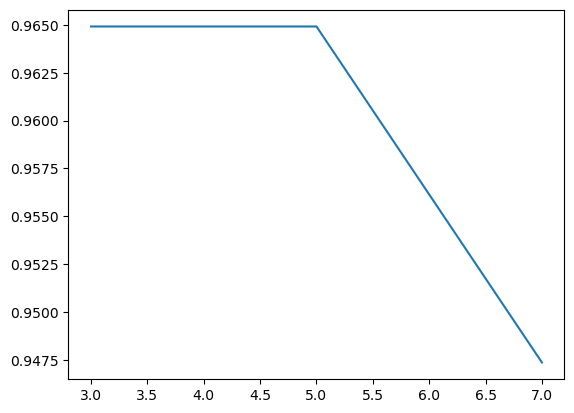

In [81]:
plt.plot((3,5,7),pl)  ## plot this three k and this mean absolute error

In [82]:
knn = KNeighborsClassifier(n_neighbors=b)  ## create object of knn  ( high accuracy comes to b point from the above )

In [83]:
knn.fit(x_train,y_train)  ## fit the model 

,n_neighbors,3
,weights,'uniform'
,algorithm,'auto'
,leaf_size,30
,p,2
,metric,'minkowski'
,metric_params,None
,n_jobs,None


In [84]:
y_pred = knn.predict(x_test)  ## predict on x_test

[[74  1]
 [ 3 36]]


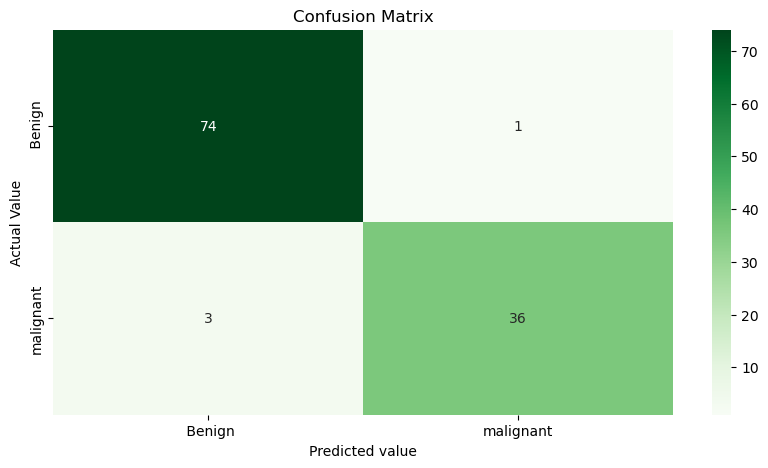

In [85]:
## show confusion matrix
cm = confusion_matrix(y_test,y_pred)
plt.figure(figsize=(10,5))
sns.heatmap(cm,cmap='Greens',annot=True,xticklabels=[' Benign','malignant'],yticklabels=[' Benign','malignant'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted value')
plt.ylabel('Actual Value')
print(cm)
## benign/malignant

In [86]:
accuracy_score(y_test,y_pred)  ## check accuracy score

0.9649122807017544

In [87]:
print(classification_report(y_test,y_pred))  ## show classificatio report

              precision    recall  f1-score   support

           0       0.96      0.99      0.97        75
           1       0.97      0.92      0.95        39

    accuracy                           0.96       114
   macro avg       0.97      0.95      0.96       114
weighted avg       0.97      0.96      0.96       114



In [ ]:
'''

Model Interpretation :
            1. Overall Accuracy (96%):

                    i) The model correctly classifies 96% of the patients, indicating excellent predictive performance.

                    ii) High accuracy suggests that:

                            Correlated features were properly removed.

                            Standard scaling helped the model learn efficiently.

                            The chosen classifier generalizes well.
            2. Confusion Matrix Interpretation:
                                [[74  1]
                                 [ 3 36]]
                           

                    True Negatives (TN): 36

                    False Positives (FP): 3

                    False Negatives (FN): 1

                    True Positives (TP): 74

                Interpretation:

                    Very few misclassifications.

                    Only 1 cancer cases were missed (FN), which is critical to analyze in medical applications.
            3. Precision Analysis:

                    * High precision for both classes indicates:

                            Few false positives.

                            Predictions are trustworthy.

                            Especially important to avoid unnecessary panic or treatment.
            4. Recall Analysis (Critical for Medical Domain):

                        Recall for malignant class (0.92) is strong but should ideally be closer to 1.0.

                        Missing cancer cases is riskier than false alarms.
            5. F1-Score Evaluation:

                        F1-scores above 0.95 indicate:

                        Excellent balance between precision and recall.

                        Stable classification performance.
            6. Macro vs Weighted Average:

                        Macro Avg F1 (0.96): Model performs well on both classes equally.

                        Weighted Avg F1 (0.96): No bias toward majority class.

                        Indicates balanced and fair model behavior.
            8. Impact of Feature Selection:

                        Dropping highly correlated features:

                        Reduced multicollinearity.

                        Improved model stability and interpretability.

                        Standard scaling ensured features contributed equally.
                        
                        
                        
Conclusion :
        1. The breast cancer classification model achieves excellent accuracy (96%), making it highly reliable.
        2. Confusion matrix shows very few misclassifications, with strong diagonal dominance.
        3. The model performs extremely well in identifying benign cases.
        4. Malignant case detection is strong, though minimizing false negatives should be a priority.
        5. Feature selection through correlation analysis significantly improved model performance.
        6. Standard scaling helped the model learn balanced decision boundaries.
        7. Overall, the model is robust, well-generalized, and suitable for clinical decision-support systems.
        8. With further tuning, the recall for malignant cases can be improved for safer medical use.


'''